In [ ]:
import os
import numpy as np
import torch
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torch import nn, optim
from matplotlib import pyplot as plt
import seaborn as sns

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


In [ ]:
path = '/content/drive/MyDrive/Abstract_gallery/'
os.path.exists(path)

True

In [ ]:
norm=((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
batch_size = 64
image_size = 64

In [ ]:
#преобразовываем данные изображения в Sensors и нормализуем их
# чтобы сделать обратное распространение более устойчивым
transf = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(*norm,inplace=True),
])

In [ ]:
from torchvision import datasets

dataset = datasets.ImageFolder(root=path,transform=transf)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

In [ ]:
def show_batch(data_loader):
    for images, labels in data_loader:
        fig, ax = plt.subplots(figsize=(15, 15))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(images[:batch_size], nrow=8).permute(1, 2, 0).clamp(0,1))
        break

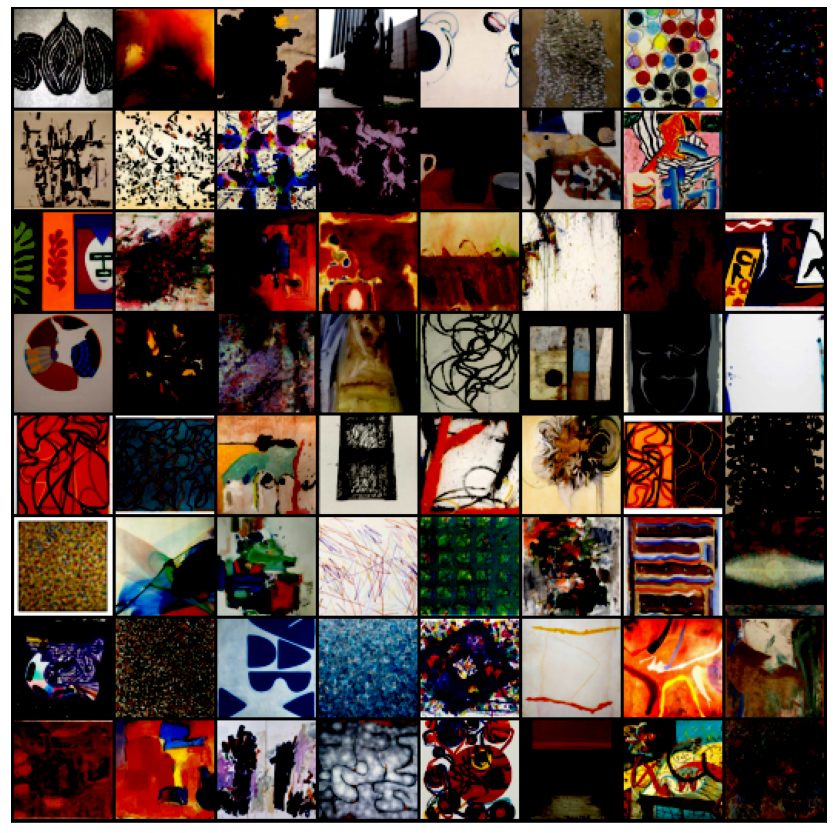

In [ ]:
show_batch(dataloader)

В документе DCGAN авторы указывают, что все веса модели должны быть случайным образом инициализированы из нормального распределения со средним значением = 0, стандартное отклонение = 0,02. Функция weights_init принимает инициализированную модель в качестве входных данных и повторно инициализирует все слои свертки, свертки-транспонирования и пакетной нормализации, чтобы они соответствовали этим критериям. Эта функция применяется к моделям сразу после инициализации.

In [ ]:
# инициализация разных весов для слоев
#источник откуда я взял эту инициализацию: (https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

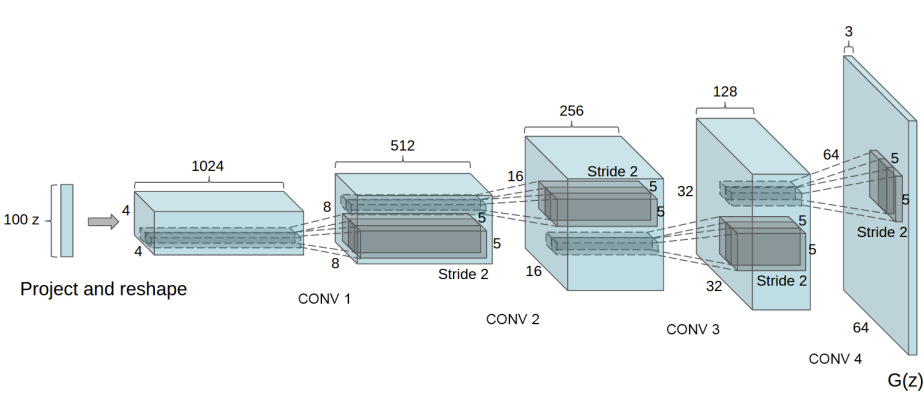

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        kernel_size = 4
        nz = 100 # длина входного вектора
        ngf = 64 # размер объекта
        nc = 3 #количество каналов в выходном изображении
        self.main = nn.Sequential(
            # входные данные - это Z, превращаем в свертку
            nn.ConvTranspose2d( nz, ngf * 8, kernel_size, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # шаг. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # шаг. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # шаг. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # шаг. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, kernel_size, 2, 1, bias=False),
            nn.Tanh()
            # шаг. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

modelG = Generator()
modelG.to(device)
modelG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

дискриминатор d представляет собой сеть бинарной классификации, которая принимает изображение в качестве входных данных и выводит скалярную вероятность того, что входное изображение является реальным (в отличие от поддельного)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        nc = 3
        ndf = 64
        kernel_size = 4
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, kernel_size, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, kernel_size, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, kernel_size, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
    
modelD = Discriminator()
modelD.to(device)
modelD.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [ ]:
# функция потерь
criterion = nn.BCELoss()

# для отслеживания прогресс обучения генератора
# (в ходе итераций узнать как из шума формируются картинки)
fixed_noise = torch.randn(64, 100, 1, 1, device=device)

real_label = 1.
fake_label = 0.

# Эти метки будут использоваться при расчете потерь D и G
# Как указано в документе DCGAN, оба являются оптимизаторами Адама со скоростью обучения 0,0002 и бета1 = 0,5.
optimizerD = optim.Adam(modelD.parameters(), lr=0.0001, betas=(0.5, 0.999))
optimizerG = optim.Adam(modelG.parameters(), lr=0.0001, betas=(0.5, 0.999))

Тренировка D заключается в максимизации log(D(x))+log(1−D(G(z)))

Будем тренировать G максимизируя log(D(G(z))) следующим образом:

In [ ]:
def unnorm(images, means, stds):
    means = torch.tensor(means).reshape(1,3,1,1)
    stds = torch.tensor(stds).reshape(1,3,1,1)
    return images*stds+means

In [ ]:
import torchvision.utils as vutils

img_list = []
G_losses, D_losses = [], []
total = 0

for epoch in range(200):
    g_loss = 0.0
    d_loss = 0.0
    D_x = 0.0
    D_G_z1 = 0.0
    D_G_z2 = 0.0
    
    # для каждого батча
    for i, data in enumerate(dataloader, 0):
        
        # Тренируем D на реальных данных

        # В PyTorch, для каждого мини-пакета на этапе обучения мы 
        # обычно хотим явно установить градиенты равными нулю, 
        #прежде чем начинать выполнять обратное распространение 
        #(т. е. обновлять веса и смещения ), потому что PyTorch 
        #накапливает градиенты при последующих обратных проходах. 
        modelD.zero_grad()

        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)

        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # отправляем батч в D
        output = modelD(real_cpu).view(-1)
        # Вычисляем функцию потерь
        errD_real = criterion(output, label)
        # Вычислите градиенты для D в обратном распространении
        errD_real.backward()
        D_x += output.mean().item()

        # Тренируем D на ненастоящих батчах

        # генерируем батч скрытых векторов
        noise = torch.randn(b_size, 100, 1, 1, device=device)
        # генерим ненастоящий батч изображения с помощью G
        fake = modelG(noise)
        label.fill_(fake_label)
        # С помощью D классифицируем батчи
        output = modelD(fake.detach()).view(-1)
        # Вычисляем потери D 
        errD_fake = criterion(output, label)
        # Вычисляем градиенты батча, накапливая с предыдущих шагов
        errD_fake.backward()
        D_G_z1 += output.mean().item()
        #Вычисляем ошибку D 
        errD = errD_real + errD_fake
        # Обновляем D
        optimizerD.step()


        ## Работаем с моделью G


        modelG.zero_grad()
        label.fill_(real_label)
        #Поскольку мы только что обновили D, выполним еще один 
        #прямой проход поддельного батча через D
        output = modelD(fake).view(-1)
        #Рассчитайте потери G на основе этого вывода
        errG = criterion(output, label)
        #Вычислите градиенты для G
        errG.backward()
        D_G_z2 += output.mean().item()
        # обновляем G
        optimizerG.step()
        
        g_loss += errG.item()
        d_loss += errD.item()
        total += b_size
        
    avg_g_loss = g_loss / total
    G_losses.append(avg_g_loss)
    avg_d_loss = d_loss / total
    D_losses.append(avg_d_loss)
    
    avg_D_x = D_x / len(dataloader)
    avg_D_G_z1 = D_G_z1 / len(dataloader)
    avg_D_G_z2 = D_G_z2 / len(dataloader)
    
    print('Epoch: {} \tDiscriminator Loss: {:.6f} \tGenerator Loss: {:.6f} \tD(x): {:.6f} \tD(G(z)): {:.6f} / {:.6f}'.format(
        epoch + 1,
        avg_d_loss,
        avg_g_loss,
        avg_D_x,
        avg_D_G_z1,
        avg_D_G_z2
    ))
    
    with torch.no_grad():
        fake = modelG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(unnorm(fake, *norm), padding=2, normalize=True))
    
print('Finished Training')

Epoch: 1 	Discriminator Loss: 0.008866 	Generator Loss: 0.084836 	D(x): 0.806069 	D(G(z)): 0.214257 / 0.018027
Epoch: 2 	Discriminator Loss: 0.001169 	Generator Loss: 0.065187 	D(x): 0.937573 	D(G(z)): 0.067731 / 0.000801
Epoch: 3 	Discriminator Loss: 0.000597 	Generator Loss: 0.058019 	D(x): 0.955680 	D(G(z)): 0.046392 / 0.000878
Epoch: 4 	Discriminator Loss: 0.000296 	Generator Loss: 0.030367 	D(x): 0.967198 	D(G(z)): 0.030000 / 0.000927
Epoch: 5 	Discriminator Loss: 0.001016 	Generator Loss: 0.028199 	D(x): 0.911098 	D(G(z)): 0.083131 / 0.012973
Epoch: 6 	Discriminator Loss: 0.000933 	Generator Loss: 0.015975 	D(x): 0.872505 	D(G(z)): 0.119822 / 0.010945
Epoch: 7 	Discriminator Loss: 0.000255 	Generator Loss: 0.014709 	D(x): 0.947536 	D(G(z)): 0.047855 / 0.002592
Epoch: 8 	Discriminator Loss: 0.000224 	Generator Loss: 0.017395 	D(x): 0.954766 	D(G(z)): 0.045339 / 0.001642
Epoch: 9 	Discriminator Loss: 0.000304 	Generator Loss: 0.014138 	D(x): 0.942882 	D(G(z)): 0.050387 / 0.004872
E

In [ ]:
torch.save(modelG.state_dict(), 'G.pth')
torch.save(modelD.state_dict(), 'D.pth')

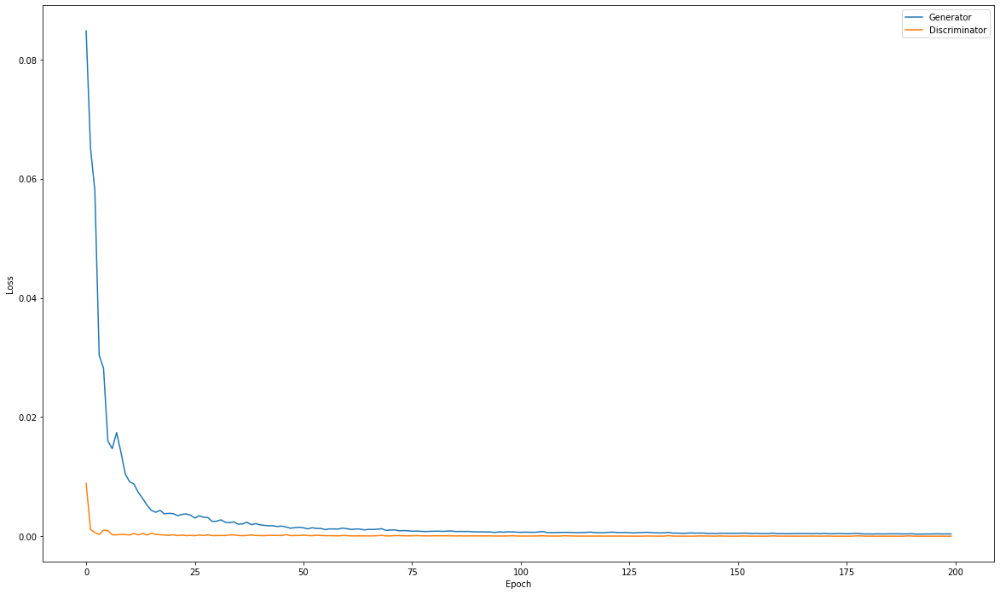

In [ ]:
plt.figure(figsize=(20,12))
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()

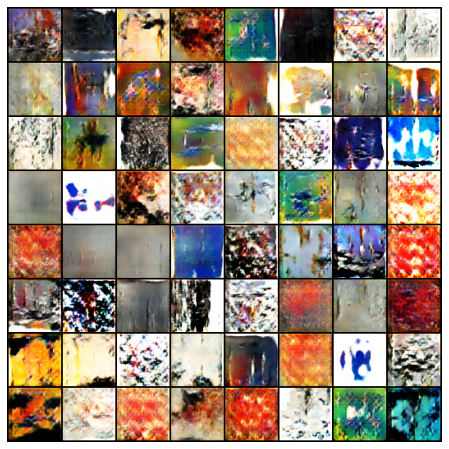

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[::6]]
ani = animation.ArtistAnimation(fig, ims, interval=250, repeat_delay=250, blit=True)

HTML(ani.to_jshtml())